In [1]:
DEBUG = False

In [2]:
import sys
sys.path.append('../HPA-competition-solutions/bestfitting/src/')

In [3]:
import time
import skimage.io
import numpy as np
import pandas as pd
import cv2
import PIL.Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SubsetRandomSampler, RandomSampler, SequentialSampler
from warmup_scheduler import GradualWarmupScheduler
from efficientnet_pytorch import model as enet
import albumentations
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import cohen_kappa_score
from tqdm import tqdm_notebook as tqdm
import os
import warnings
import cv2
from sklearn.metrics import average_precision_score
import pickle

warnings.filterwarnings('ignore') 

In [4]:
from config.config import *
from networks.densenet import *
from datasets.tool import *
from torch.utils.data import Dataset
import pandas as pd
import torchvision
import torch
import cv2
import os

import time
import shutil
from sklearn.metrics import f1_score

import torch
import torch.optim
from torch.utils.data import DataLoader
from torch.utils.data.sampler import RandomSampler, SequentialSampler
from torch.nn import DataParallel
from torch.backends import cudnn
import torch.nn.functional as F
from torch.autograd import Variable

from config.config import *
from utils.common_util import *
from networks.imageclsnet import init_network
from datasets.protein_dataset import ProteinDataset
from utils.augment_util import train_multi_augment2
from layers.loss import *
from layers.scheduler import *
from utils.log_util import Logger

run on pazur


In [5]:
kernel_type = 'bfl_1'

fold = 0
image_size = 1536
crop_size = 1024
batch_size = 8
ITERS_TO_ACCUMULATE = 4
num_workers = 8
out_dim = 19
init_lr = 3e-4
nseed = 2 if DEBUG else 3
nfold = 2 if DEBUG else 3
seed = 42

warmup_epo = 1
n_epochs = 3 if DEBUG else 6

device = torch.device('cuda')

In [6]:
df = pd.read_csv('../folds_large.csv')

In [7]:
train_folder = '/media/darek/projects/hpa/hpa_train_full'
public__folder = '/media/darek/projects/hpa/hpa_public_full'

df_t = df[df.dataset == 'train']
df_p = df[df.dataset == 'public']
df_t['fpath'] = df_t.ID.apply(lambda r: os.path.join(train_folder, r))
df_p['fpath'] = df_p.ID.apply(lambda r: os.path.join(public__folder, r))

df_train = pd.concat([df_t, df_p], ignore_index=True)
df_train.drop_duplicates(inplace=True)
df_train.reset_index(drop=True, inplace=True)
df_train['Label'] = df_train['Label'].astype(str)
df_train.head()

,ID,Label,dataset,fold,fpath
0,12d0e1dc-bbc7-11e8-b2bc-ac1f6b6435d0,14,train,4,/media/darek/projects/hpa/hpa_train_full/12d0e...
1,836a3fb4-bba5-11e8-b2ba-ac1f6b6435d0,14,train,0,/media/darek/projects/hpa/hpa_train_full/836a3...
2,5a474b22-bba5-11e8-b2ba-ac1f6b6435d0,5,train,1,/media/darek/projects/hpa/hpa_train_full/5a474...
3,a2a59eea-bba6-11e8-b2ba-ac1f6b6435d0,2,train,0,/media/darek/projects/hpa/hpa_train_full/a2a59...
4,d6118772-bba5-11e8-b2ba-ac1f6b6435d0,16|10|13,train,0,/media/darek/projects/hpa/hpa_train_full/d6118...


In [8]:
df_train = df_train.sample(256).reset_index(drop=True) if DEBUG else df_train

In [9]:
labels = [str(i) for i in range(19)]
full_counts = {}
fsum = 0
for lbl in labels:
    count = 0
    for row_label in df_train['Label']:
        if lbl in row_label.split('|'): count += 1
    full_counts[lbl] = count
    fsum += count
full_counts['avg'] = int(fsum/(len(labels)))

counts = list(zip(full_counts.keys(), full_counts.values()))
counts = np.array(sorted(counts, key=lambda x:-x[1]))
counts = pd.DataFrame(counts, columns=['label', 'full_count'])
counts.set_index('label', inplace=True)
counts.T

label,0,17,16,18,13,4,avg,2,12,5,7,14,6,3,9,1,10,8,15,11
full_count,8797,6471,5685,5265,4127,3143,2979,2754,2567,2555,2436,2328,2162,1818,1658,1585,1503,1301,312,141


## Model

In [10]:
dm = torchvision.models.densenet121(pretrained=True)

In [11]:
def get_model(n):
    
    n = n % 3
    model_file = f'../protein_models/models/external_crop1024_focal_slov_hardlog_clean_class_densenet121_large_dropout_i1536_aug2_5folds/fold{n}/final.pth'

    model = class_densenet121_dropout(num_classes=19, in_channels=4, pretrained_file='/home/darek/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth')
    weights = torch.load(model_file)
    pretrained_dict = weights['state_dict']
    model_dict = model.state_dict()

    # 1. filter out unnecessary keys
    pretrained_dict = {k: v for k, v in pretrained_dict.items() if k not in ['logit.weight', 'logit.bias']}
    # 2. overwrite entries in the existing state dict
    model_dict.update(pretrained_dict)
    # 3. load the new state dict
    model.load_state_dict(model_dict)

    i = 0
    for child in model.children():
        if i < 6:
            for param in child.parameters():
                param.requires_grad = False
        i += 1
    return model

In [12]:
def get_model_test():
    model = class_densenet121_dropout(num_classes=19, in_channels=4, pretrained_file='/home/darek/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth')
    return model

In [13]:
def open_rgby(fpath, yellow=True): #a function that reads RGBY image    
    if yellow: colors = ['red','green','blue','yellow']
    else: colors = ['red','green','blue']
    flags = cv2.IMREAD_GRAYSCALE
    img = [cv2.imread(fpath+'_'+color+'.png', flags) for color in colors]
    
    return np.stack(img, axis=-1)

## Dataset

In [14]:
class HPADataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        fpath = row.fpath
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        image /= 255 #moved to albumentations normalize
        image = image.transpose(2, 0, 1)

        label = np.zeros(out_dim).astype(np.float32)
        img_lbls = [int(x) for x in row.Label.split('|')]
        for i in img_lbls: label[i] = 1.
        return torch.tensor(image), torch.tensor(label)

## Augmentations

In [15]:
from albumentations.core.transforms_interface import ImageOnlyTransform

class Gridify(ImageOnlyTransform):

    def __init__(
        self,
        grid_size=2048,
        always_apply=False,
        p=1.0,
    ):
        super(Gridify, self).__init__(always_apply, p)
        self.grid_size = grid_size
        self.transform = albumentations.Compose([
            albumentations.VerticalFlip(p=0.5),
            albumentations.HorizontalFlip(p=0.5),
        ])

    def apply(self, image, **params):
        grid = np.zeros((self.grid_size,self.grid_size, 4)).astype(np.uint8)
        ch,cw,_ = image.shape
        gh,gw,_ = grid.shape
        hsteps = np.ceil(gh/ch).astype(int)
        wsteps = np.ceil(gw/cw).astype(int)

        h,w = ch,cw
        hmargin = ch

        for i in range(hsteps):
            wmargin = cw
            h = ch * (i+1)
            if h > gh:
                hmargin = gh-h
                h = gh
            for j in range(wsteps):
                transformed = self.transform(image=image)
                transformed_image = transformed["image"]
                w = cw * (j+1)
                if w > gw:
                    wmargin = gw-w
                    w = gw
                grid[ch*i:h,cw*j:w,:] = transformed_image[:hmargin,:wmargin,:]
        return grid        

    def get_transform_init_args_names(self):
        return ("grid_size")

In [16]:
mean = (0.07237246, 0.04476176, 0.07661699)
std = (0.17179589, 0.10284516, 0.14199627)


transforms_train = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
    albumentations.RandomCrop(crop_size, crop_size, p=1.),
    albumentations.VerticalFlip(p=0.5),
    albumentations.HorizontalFlip(p=0.5),
    albumentations.RandomRotate90(p=0.5),
])

transforms_val = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
])

transforms_grid1 = albumentations.Compose([
    Gridify(grid_size=2048),
    albumentations.Resize(image_size, image_size, p=1.),
])
transforms_grid2 = albumentations.Compose([
    Gridify(grid_size=1728),
    albumentations.Resize(image_size, image_size, p=1.),
])
transforms_grid3 = albumentations.Compose([
    Gridify(grid_size=3072),
    albumentations.Resize(image_size, image_size, p=1.),
])

In [17]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std
    def __call__(self, tensor):
        return tensor

In [18]:
def tensor2label(t):
    l = t.numpy().tolist()
    l = [i for i,v in enumerate(l) if v==1.]
    return str(l)
label = torch.tensor(np.array([1.,0,1,0]))
tensor2label(label)

'[0, 2]'

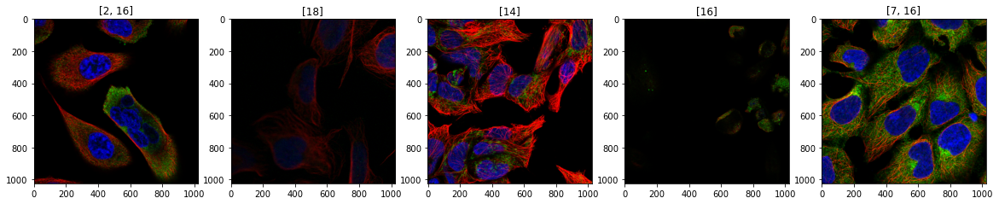

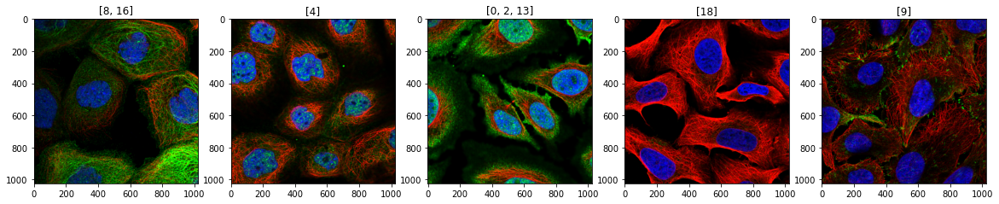

In [19]:
unnorm = UnNormalize(mean, std)
dataset_show = HPADataset(df_train, transform=transforms_train)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img, label = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[p].set_title(tensor2label(label))


## Loss

In [20]:
class FocalLoss(nn.Module):
    def __init__(self, gamma=2):
        super().__init__()
        self.gamma = gamma
        
    def forward(self, inputs, target):
        if not (target.size() == inputs.size()):
            raise ValueError("Target size ({}) must be the same as input size ({})"
                             .format(target.size(), input.size()))

        max_val = (-inputs).clamp(min=0)
        loss = inputs - inputs * target + max_val + \
            ((-max_val).exp() + (-inputs - max_val).exp()).log()

        invprobs = F.logsigmoid(-inputs * (target * 2.0 - 1.0))
        loss = (invprobs * self.gamma).exp() * loss
        
        return loss.sum(dim=1).mean()

In [21]:
# criterion = nn.BCEWithLogitsLoss()
criterion = FocalSymmetricLovaszHardLogLoss().cuda()
focal = FocalLoss().cuda()

## Train and Val

In [22]:
def train_epoch(loader, optimizer, scaler):

    model.train()
    train_loss = []
    bar = tqdm(loader)
    for i, (data, target) in enumerate(bar):
        
        data, target = data.to(device), target.to(device)
        loss_func = criterion
        
        
        with torch.cuda.amp.autocast():
            logits = model(data)
            loss = loss_func(logits, target)
            loss = loss / ITERS_TO_ACCUMULATE
                        
        scaler.scale(loss).backward()
        
        if (i + 1) % ITERS_TO_ACCUMULATE == 0:      
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()
        
        loss_np = loss.detach().cpu().numpy()
        train_loss.append(loss_np)
        smooth_loss = sum(train_loss[-100:]) / min(len(train_loss), 100)
        bar.set_description('loss: %.5f, smth: %.5f' % (loss_np, smooth_loss))
    return train_loss


def val_epoch(loader, get_output=False):

    model.eval()
    val_loss = []
    val_focal = []
    LOGITS = []
    PREDS = []
    TARGETS = []

    with torch.no_grad():
        for (data, target) in tqdm(loader):
            data, target = data.to(device), target.to(device)
            logits = model(data)
            loss = criterion(logits, target)
            foc = focal(logits, target)
            pred = logits.sigmoid().detach()
            LOGITS.append(logits)
            PREDS.append(pred)
            TARGETS.append(target)
            val_loss.append(loss.detach().cpu().numpy())
            val_focal.append(foc.detach().cpu().numpy())         

        val_loss = np.mean(val_loss)
        val_focal = np.mean(val_focal)

    LOGITS = torch.cat(LOGITS).cpu().numpy()
    PREDS = torch.cat(PREDS).cpu().numpy()
    TARGETS = torch.cat(TARGETS).cpu().numpy()
    
    average_precision = dict()
    for i in range(out_dim):
        average_precision[i] = average_precision_score(TARGETS[:, i], PREDS[:, i])
    average_precision["macro"] = average_precision_score(TARGETS, PREDS, average="macro")
    
    print('Average precision:')
    print(average_precision)

    if get_output:
        return LOGITS
    else:
        return val_loss, val_focal, average_precision["macro"], average_precision

## Run Training

In [23]:
checkpoints = []

for fold in range(nfold):
    seed = fold
    print('#'*60)
    print(f'Training fold {fold}')
    print('#'*60)

    train_idx = np.where((df_train['fold'] != fold))[0]
    valid_idx = np.where((df_train['fold'] == fold))[0]

    df_this  = df_train.loc[train_idx]
    df_valid = df_train.loc[valid_idx]

    dataset_train = HPADataset(df_this, transform=transforms_train)
    dataset_valid = HPADataset(df_valid, transform=transforms_val)

    train_loader = torch.utils.data.DataLoader(dataset_train, batch_size=batch_size, sampler=RandomSampler(dataset_train), num_workers=num_workers)
    valid_loader = torch.utils.data.DataLoader(dataset_valid, batch_size=batch_size, sampler=SequentialSampler(dataset_valid), num_workers=num_workers)

    model = get_model(seed)
    model = model.to(device)

    scaler = torch.cuda.amp.GradScaler()

    optimizer = optim.Adam(model.parameters(), lr=init_lr)
    scheduler = lr_scheduler.CosineAnnealingLR(optimizer, n_epochs, eta_min=2e-5)

    print(len(dataset_train), len(dataset_valid))

    for epoch in range(1, n_epochs+1):
        print(time.ctime(), 'Epoch:', epoch)
        checkpoint_file = f'{kernel_type}_model_seed_{seed}_fold_{fold}_epoch_{epoch}.pth'

        if epoch == 2:
            for param in model.parameters():
                param.requires_grad = True
            print('Unfreezing!')
            optimizer = optim.Adam(model.parameters(), lr=init_lr/10)
            scheduler = lr_scheduler.CosineAnnealingLR(optimizer, n_epochs, eta_min=1e-5)

        train_loss = train_epoch(train_loader, optimizer, scaler)
        val_loss, val_focal, aps, apsdict = val_epoch(valid_loader)
        scheduler.step()

        content = time.ctime() + ' ' + f'Epoch {epoch}, lr: {optimizer.param_groups[0]["lr"]:.7f}, train loss: {np.mean(train_loss):.5f}, val loss: {np.mean(val_loss):.5f}, aps: {(aps):.5f}'
        print(content)
        with open(f'log_{kernel_type}.txt', 'a') as appender:
            appender.write(content + '\n')

        torch.save(model.state_dict(), checkpoint_file)

        res = {
            'checkpoint': checkpoint_file,
            'val_loss': val_loss,
            'val_focal': val_focal,
            'aps': aps,
            'aps_dict': apsdict,
            'seed': seed,
            'fold': fold,
            'epoch': epoch,
        }
        checkpoints.append(res)
            

############################################################
Training fold 0
############################################################
31350 8165
Sat Apr 24 00:34:58 2021 Epoch: 1


  0%|          | 0/3919 [00:00<?, ?it/s]

  0%|          | 0/1021 [00:00<?, ?it/s]

Average precision:
{0: 0.8478265974787584, 1: 0.9078692036417282, 2: 0.6486159650532869, 3: 0.7393929642301257, 4: 0.8434643193451872, 5: 0.7810887619141389, 6: 0.8278693135359634, 7: 0.7644948543705222, 8: 0.8064022524454325, 9: 0.7544275412362028, 10: 0.9429083271283281, 11: 0.28483139040674615, 12: 0.7119517270986134, 13: 0.7456921445495995, 14: 0.820866089389676, 15: 0.5323704707659653, 16: 0.6140463266580862, 17: 0.8205218188289457, 18: 0.8825754551427958, 'macro': 0.7514323959589526}
Sat Apr 24 00:53:15 2021 Epoch 1, lr: 0.0002812, train loss: 0.19615, val loss: 0.56833, aps: 0.75143
Sat Apr 24 00:53:15 2021 Epoch: 2
Unfreezing!


  0%|          | 0/3919 [00:00<?, ?it/s]

  0%|          | 0/1021 [00:00<?, ?it/s]

Average precision:
{0: 0.8841546147228392, 1: 0.9331422855655167, 2: 0.8275880618064456, 3: 0.8539168832365174, 4: 0.9198861837914327, 5: 0.8351044590877057, 6: 0.8534067930920736, 7: 0.8429103557278081, 8: 0.8779941635912115, 9: 0.8365787379155566, 10: 0.9582605643744231, 11: 0.36324394582125485, 12: 0.8278070592221212, 13: 0.7987316427226312, 14: 0.8860974560660952, 15: 0.7458228828324774, 16: 0.6364828911020131, 17: 0.8585326512244741, 18: 0.9124571463892392, 'macro': 0.8237957251732545}
Sat Apr 24 01:28:37 2021 Epoch 2, lr: 0.0000287, train loss: 0.14980, val loss: 0.47732, aps: 0.82380
Sat Apr 24 01:28:37 2021 Epoch: 3


  0%|          | 0/3919 [00:00<?, ?it/s]

  0%|          | 0/1021 [00:00<?, ?it/s]

Average precision:
{0: 0.8897770525322964, 1: 0.9387290459737402, 2: 0.8400158151866102, 3: 0.8598624423792708, 4: 0.9259856154480347, 5: 0.845410868446338, 6: 0.858440858173164, 7: 0.8530876405343708, 8: 0.8779480546612919, 9: 0.8614581568499157, 10: 0.9599571744464954, 11: 0.3626972138265135, 12: 0.838496034776599, 13: 0.8101500323619127, 14: 0.8916047430892576, 15: 0.772008902738923, 16: 0.6456392262973827, 17: 0.8713602481680407, 18: 0.9150276220633502, 'macro': 0.8325082498922898}
Sat Apr 24 02:04:04 2021 Epoch 3, lr: 0.0000250, train loss: 0.14044, val loss: 0.45804, aps: 0.83251
Sat Apr 24 02:04:05 2021 Epoch: 4


  0%|          | 0/3919 [00:00<?, ?it/s]

  0%|          | 0/1021 [00:00<?, ?it/s]

Average precision:
{0: 0.8926596403911217, 1: 0.9402054138287259, 2: 0.8527583524673686, 3: 0.8596393532322149, 4: 0.9282043553214083, 5: 0.8516015620618903, 6: 0.8605064492932445, 7: 0.8575040732410445, 8: 0.8849510094343652, 9: 0.8722183487594571, 10: 0.9602259554225896, 11: 0.38855686231750647, 12: 0.843912093858326, 13: 0.8119112697906118, 14: 0.8975273410046833, 15: 0.7812337217889705, 16: 0.6570090279554962, 17: 0.8762990361509844, 18: 0.9212146819197921, 'macro': 0.838849397275779}
Sat Apr 24 02:39:32 2021 Epoch 4, lr: 0.0000200, train loss: 0.13638, val loss: 0.44105, aps: 0.83885
Sat Apr 24 02:39:32 2021 Epoch: 5


  0%|          | 0/3919 [00:00<?, ?it/s]

  0%|          | 0/1021 [00:00<?, ?it/s]

Average precision:
{0: 0.8958059642933697, 1: 0.9417228329040761, 2: 0.8554725172924409, 3: 0.8658852502444947, 4: 0.9290994989926906, 5: 0.8516205559727179, 6: 0.8626244319970765, 7: 0.8652571387373297, 8: 0.8851613797865969, 9: 0.8730534952748066, 10: 0.9600679186660552, 11: 0.3944113357973998, 12: 0.8491362078234825, 13: 0.8130073552680627, 14: 0.893884529214303, 15: 0.7754253921667333, 16: 0.6575671495751914, 17: 0.879509041011951, 18: 0.9179673398451609, 'macro': 0.8403515439402074}
Sat Apr 24 03:15:00 2021 Epoch 5, lr: 0.0000150, train loss: 0.13376, val loss: 0.44159, aps: 0.84035
Sat Apr 24 03:15:00 2021 Epoch: 6


  0%|          | 0/3919 [00:00<?, ?it/s]

  0%|          | 0/1021 [00:00<?, ?it/s]

Average precision:
{0: 0.8968755147868341, 1: 0.9436926112627432, 2: 0.8596586674219624, 3: 0.8668604726731644, 4: 0.9283834325931254, 5: 0.8497809196398118, 6: 0.8642880626212193, 7: 0.8677957427827487, 8: 0.8860795645606484, 9: 0.8774281627144271, 10: 0.9573801274485659, 11: 0.4043365748701142, 12: 0.8467805512407617, 13: 0.813128937362911, 14: 0.8975909937080583, 15: 0.7754174795982716, 16: 0.660563433731074, 17: 0.8778871279648963, 18: 0.9231819765922183, 'macro': 0.8419531765038715}
Sat Apr 24 03:50:26 2021 Epoch 6, lr: 0.0000113, train loss: 0.13224, val loss: 0.44419, aps: 0.84195
############################################################
Training fold 1
############################################################
31611 7904
Sat Apr 24 03:50:26 2021 Epoch: 1


  0%|          | 0/3952 [00:00<?, ?it/s]

  0%|          | 0/988 [00:00<?, ?it/s]

Average precision:
{0: 0.8516008681968372, 1: 0.9064806700286604, 2: 0.7508305849272692, 3: 0.8172148151246904, 4: 0.8821649962898234, 5: 0.7658470793918102, 6: 0.7761961764547638, 7: 0.747305622436807, 8: 0.787366689138408, 9: 0.7250100858758574, 10: 0.9601540538314184, 11: 0.3535951279452516, 12: 0.7520501430693585, 13: 0.71128053334549, 14: 0.795104635484189, 15: 0.3239230406606961, 16: 0.6273685350631362, 17: 0.814319680768078, 18: 0.8978578089506033, 'macro': 0.7497721656306918}
Sat Apr 24 04:08:32 2021 Epoch 1, lr: 0.0002812, train loss: 0.19666, val loss: 0.55944, aps: 0.74977
Sat Apr 24 04:08:32 2021 Epoch: 2
Unfreezing!


  0%|          | 0/3952 [00:00<?, ?it/s]

  0%|          | 0/988 [00:00<?, ?it/s]

Average precision:
{0: 0.8825777657733539, 1: 0.9310441449006706, 2: 0.8361771976727169, 3: 0.8847003717252474, 4: 0.9365009428526538, 5: 0.8160809137101125, 6: 0.8152653626126659, 7: 0.8398705706679778, 8: 0.8625663513502636, 9: 0.8154519778304749, 10: 0.9783478123928494, 11: 0.3386735445853452, 12: 0.8300834343156992, 13: 0.7548920884244663, 14: 0.8607450215323088, 15: 0.5381872588547457, 16: 0.6662032004940398, 17: 0.8539776949360897, 18: 0.919117895839401, 'macro': 0.8084454500247938}
Sat Apr 24 04:44:00 2021 Epoch 2, lr: 0.0000287, train loss: 0.14839, val loss: 0.48021, aps: 0.80845
Sat Apr 24 04:44:00 2021 Epoch: 3


  0%|          | 0/3952 [00:00<?, ?it/s]

  0%|          | 0/988 [00:00<?, ?it/s]

Average precision:
{0: 0.8897638671981098, 1: 0.9370700758950198, 2: 0.8390544053171858, 3: 0.8929056592850536, 4: 0.9419383258204415, 5: 0.8234830813358687, 6: 0.8234677600741729, 7: 0.8499491356896994, 8: 0.879337350440539, 9: 0.8410938925087309, 10: 0.9796236684713289, 11: 0.37958083339163917, 12: 0.8412076428869982, 13: 0.7730109136689655, 14: 0.8677052540432949, 15: 0.5823536037607148, 16: 0.6739637283173961, 17: 0.8617051192221648, 18: 0.9242821082843092, 'macro': 0.821131390821665}
Sat Apr 24 05:19:29 2021 Epoch 3, lr: 0.0000250, train loss: 0.13869, val loss: 0.45486, aps: 0.82113
Sat Apr 24 05:19:29 2021 Epoch: 4


  0%|          | 0/3952 [00:00<?, ?it/s]

  0%|          | 0/988 [00:00<?, ?it/s]

Average precision:
{0: 0.8944527745318929, 1: 0.9389465476065239, 2: 0.8444868044023677, 3: 0.8967476533992266, 4: 0.942892311608165, 5: 0.8261372399898163, 6: 0.8255187226981262, 7: 0.8562398467134378, 8: 0.880938036248703, 9: 0.8481153484559377, 10: 0.9792085190104431, 11: 0.44819123737170624, 12: 0.8423519273739042, 13: 0.7673171214405475, 14: 0.8688511725331218, 15: 0.6196086882432905, 16: 0.679374370279925, 17: 0.8682610780686579, 18: 0.925276611254037, 'macro': 0.8291008426963069}
Sat Apr 24 05:54:57 2021 Epoch 4, lr: 0.0000200, train loss: 0.13532, val loss: 0.45135, aps: 0.82910
Sat Apr 24 05:54:57 2021 Epoch: 5


  0%|          | 0/3952 [00:00<?, ?it/s]

  0%|          | 0/988 [00:00<?, ?it/s]

Average precision:
{0: 0.8940454550450997, 1: 0.9381379458989212, 2: 0.8500734550736033, 3: 0.8976193907935521, 4: 0.9461357407267732, 5: 0.8280214200682856, 6: 0.822216358436666, 7: 0.8586635533182865, 8: 0.8822696021441849, 9: 0.8470631063793844, 10: 0.980764807353284, 11: 0.4526257128735353, 12: 0.8442183925593393, 13: 0.7701624417424775, 14: 0.8722231725903223, 15: 0.6256161569232404, 16: 0.6823112693404585, 17: 0.8750327526541917, 18: 0.9289894966283075, 'macro': 0.8313784331868376}
Sat Apr 24 06:30:26 2021 Epoch 5, lr: 0.0000150, train loss: 0.13262, val loss: 0.45921, aps: 0.83138
Sat Apr 24 06:30:26 2021 Epoch: 6


  0%|          | 0/3952 [00:00<?, ?it/s]

  0%|          | 0/988 [00:00<?, ?it/s]

Average precision:
{0: 0.8963158784248962, 1: 0.9414658102389124, 2: 0.8537458364957677, 3: 0.9008965094499879, 4: 0.9471781883802609, 5: 0.8333339343169552, 6: 0.8283608261074322, 7: 0.8615836079147461, 8: 0.8887858926014567, 9: 0.852385325787224, 10: 0.9805015900338083, 11: 0.49822783806362564, 12: 0.8483179916313457, 13: 0.7769320508116762, 14: 0.8743366522759738, 15: 0.6303010786125208, 16: 0.6847148455764789, 17: 0.877083929162041, 18: 0.9319660519228757, 'macro': 0.8371807283056835}
Sat Apr 24 07:06:19 2021 Epoch 6, lr: 0.0000113, train loss: 0.13070, val loss: 0.44350, aps: 0.83718
############################################################
Training fold 2
############################################################
31458 8057
Sat Apr 24 07:06:20 2021 Epoch: 1


  0%|          | 0/3933 [00:00<?, ?it/s]

  0%|          | 0/1008 [00:00<?, ?it/s]

Average precision:
{0: 0.8431968838108747, 1: 0.9368489827219593, 2: 0.6808765209960577, 3: 0.7609748232469079, 4: 0.8973858796725122, 5: 0.7142723576203834, 6: 0.8445398079950162, 7: 0.7451615882743842, 8: 0.8206355306119719, 9: 0.7429916869851321, 10: 0.9431293744901618, 11: 0.2125970334532257, 12: 0.6543390391988504, 13: 0.6951537552624706, 14: 0.8159373335144048, 15: 0.5186083709124112, 16: 0.6356742163031307, 17: 0.8327872072461244, 18: 0.8902937029875352, 'macro': 0.7466002155422902}
Sat Apr 24 07:24:57 2021 Epoch 1, lr: 0.0002812, train loss: 0.19691, val loss: 0.56095, aps: 0.74660
Sat Apr 24 07:24:57 2021 Epoch: 2
Unfreezing!


  0%|          | 0/3933 [00:00<?, ?it/s]

  0%|          | 0/1008 [00:00<?, ?it/s]

Average precision:
{0: 0.8737438584722406, 1: 0.9467492454718744, 2: 0.8220950971771325, 3: 0.8657446931801926, 4: 0.9366903423536558, 5: 0.7955989880738844, 6: 0.8633595134228901, 7: 0.8233482944351379, 8: 0.8954311950369963, 9: 0.8384138597636674, 10: 0.9602645617198, 11: 0.3409260184545885, 12: 0.8247596041573422, 13: 0.7482931020772123, 14: 0.8716275744760512, 15: 0.6985851249553064, 16: 0.6722098906575797, 17: 0.872578949063438, 18: 0.9155880895112847, 'macro': 0.8192635790768567}
Sat Apr 24 08:00:29 2021 Epoch 2, lr: 0.0000287, train loss: 0.14953, val loss: 0.48594, aps: 0.81926
Sat Apr 24 08:00:29 2021 Epoch: 3


  0%|          | 0/3933 [00:00<?, ?it/s]

  0%|          | 0/1008 [00:00<?, ?it/s]

Average precision:
{0: 0.8796266450380159, 1: 0.9570001221893475, 2: 0.8378634830801553, 3: 0.8750706432504617, 4: 0.9355336618650879, 5: 0.7997996099351194, 6: 0.8709392226642049, 7: 0.8333086237716903, 8: 0.9083406056352643, 9: 0.8576399980334953, 10: 0.9616216479486903, 11: 0.3798157911774676, 12: 0.8368967150941796, 13: 0.7632751072420825, 14: 0.8758841921799263, 15: 0.7234118691787106, 16: 0.6811334270582311, 17: 0.8883093609537879, 18: 0.923891209815461, 'macro': 0.8310190492690199}
Sat Apr 24 08:36:04 2021 Epoch 3, lr: 0.0000250, train loss: 0.13983, val loss: 0.45516, aps: 0.83102
Sat Apr 24 08:36:04 2021 Epoch: 4


  0%|          | 0/3933 [00:00<?, ?it/s]

  0%|          | 0/1008 [00:00<?, ?it/s]

Average precision:
{0: 0.8846950879946003, 1: 0.9587727984605042, 2: 0.8467943991538118, 3: 0.8788680223202958, 4: 0.9368435471684929, 5: 0.8070987256406355, 6: 0.8749306270643392, 7: 0.8339607733993845, 8: 0.9094516760272957, 9: 0.863734399581748, 10: 0.9634791453920577, 11: 0.4201789700568674, 12: 0.8450348074906959, 13: 0.7775282709119865, 14: 0.879453731575966, 15: 0.7201761585970557, 16: 0.6921392327955672, 17: 0.8951166005991132, 18: 0.9239537126208096, 'macro': 0.83748477299217}
Sat Apr 24 09:11:36 2021 Epoch 4, lr: 0.0000200, train loss: 0.13680, val loss: 0.44188, aps: 0.83748
Sat Apr 24 09:11:36 2021 Epoch: 5


  0%|          | 0/3933 [00:00<?, ?it/s]

  0%|          | 0/1008 [00:00<?, ?it/s]

Average precision:
{0: 0.8846808876069802, 1: 0.9581340139127638, 2: 0.848154625640597, 3: 0.8858782555291067, 4: 0.9360329324346323, 5: 0.8067671749075783, 6: 0.8717955245062408, 7: 0.8385609240143274, 8: 0.9107161609157857, 9: 0.8710863772049482, 10: 0.9653318032331459, 11: 0.43940559756943676, 12: 0.8441093944274307, 13: 0.7702525916651293, 14: 0.8828359593722003, 15: 0.7378017125956546, 16: 0.6903688827854798, 17: 0.8969289212967623, 18: 0.9266543196499378, 'macro': 0.8402892662772704}
Sat Apr 24 09:47:06 2021 Epoch 5, lr: 0.0000150, train loss: 0.13493, val loss: 0.44007, aps: 0.84029
Sat Apr 24 09:47:06 2021 Epoch: 6


  0%|          | 0/3933 [00:00<?, ?it/s]

  0%|          | 0/1008 [00:00<?, ?it/s]

Average precision:
{0: 0.8866391754866352, 1: 0.9567999761038893, 2: 0.8526002955245003, 3: 0.8862169974502488, 4: 0.9377099623747118, 5: 0.8124421230809312, 6: 0.8738480925219643, 7: 0.8442664974891916, 8: 0.9134892205426114, 9: 0.8742050536842019, 10: 0.965396419078076, 11: 0.45162039777778035, 12: 0.8503147917209375, 13: 0.7803864212072845, 14: 0.884853561196474, 15: 0.7300043309860436, 16: 0.6979996146802193, 17: 0.898514566685566, 18: 0.9271137675143769, 'macro': 0.843390592900297}
Sat Apr 24 10:22:35 2021 Epoch 6, lr: 0.0000113, train loss: 0.13222, val loss: 0.43039, aps: 0.84339


In [24]:
checkpoint_df = pd.DataFrame(checkpoints)
checkpoint_df.to_csv('checkpoints.csv', index=False)

In [25]:
means = pd.DataFrame()
means['aps'] = checkpoint_df.groupby('epoch')['aps'].mean()
means['val_focal'] = checkpoint_df.groupby('epoch')['val_focal'].mean()
means

,aps,val_focal
epoch,,
1,0.749268,0.569874
2,0.817168,0.482395
3,0.828220,0.458501
4,0.835145,0.446267
5,0.837340,0.449085
6,0.840841,0.440426


## Test Inference

In [26]:
test_image_folder = '/media/darek/projects/hpa/testrgby/test_cells/test_cells'
test_df = pd.read_csv('/media/darek/projects/hpa/testrgby/test_cell_df.csv')
test_df.head()

,image_id,cell_id,size1,size2,enc
0,0040581b-f1f2-4fbe-b043-b6bfea5404bb,1,342,1050,eNqtVm2PojAQ/ksMZe+Sy21yubtc4gKDIkpBUJQ3KyD//9...
1,0040581b-f1f2-4fbe-b043-b6bfea5404bb,2,762,680,eNrVUm1PwkAM/kvt3XgRjEajvO7uhGCEEHCgcSQi/v9vXt...
2,0040581b-f1f2-4fbe-b043-b6bfea5404bb,3,398,470,eNoLCEgJMg4wDMg3NPQ39Df2NfaF0EZ+IBoBIXzc8oSgAR...
3,0040581b-f1f2-4fbe-b043-b6bfea5404bb,4,372,344,eNptUstOAzEM/CUnXtoiAQcegnbzOMAFgdRFbIXEpf9/q+...
4,0040581b-f1f2-4fbe-b043-b6bfea5404bb,5,544,244,eNp9UcuSmzAQ/CVGku1U8CGpxBs7EsMrPNdgMNYasIH/v0...


In [27]:
test_df = test_df.sample(256).reset_index(drop=True) if DEBUG else test_df

In [28]:
len(test_df)

10716

In [29]:
class HPATestDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        img_id = row.image_id
        cell_id = row.cell_id
        cell_image_id = str(img_id) + '_' + str(cell_id)
        fpath = os.path.join(test_image_folder, cell_image_id)
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        image /= 255
        image = image.transpose(2, 0, 1)

        return torch.tensor(image)

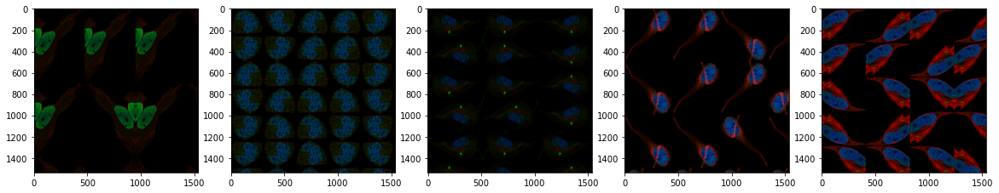

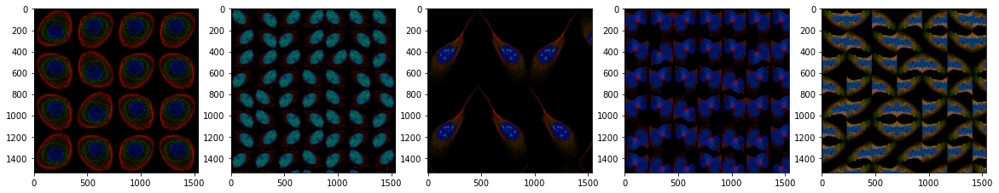

In [30]:
dataset_show = HPATestDataset(test_df, transform=transforms_grid1)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())

In [31]:
unnorm(dataset_show[9][0]).max()

tensor(0.9529)

In [32]:
dataset1 = HPATestDataset(test_df, transform=transforms_grid1)
loader1 = DataLoader(dataset1, batch_size=batch_size, num_workers=num_workers, shuffle=False)

dataset2 = HPATestDataset(test_df, transform=transforms_grid2)
loader2 = DataLoader(dataset2, batch_size=batch_size, num_workers=num_workers, shuffle=False)

dataset3 = HPATestDataset(test_df, transform=transforms_grid3)
loader3 = DataLoader(dataset3, batch_size=batch_size, num_workers=num_workers, shuffle=False)

# loaders = [loader1, loader2, loader3] #TTA
loaders = [loader1]

In [33]:
model_dir = '.'

In [34]:
def load_models(model_files):
    models = []
    for model_f in model_files:
        model_f = os.path.join(model_dir, model_f)
        model = get_model_test()
        model.load_state_dict(torch.load(model_f, map_location=lambda storage, loc: storage), strict=True)
        model.eval()
        model.to(device)
        models.append(model)
        print(f'{model_f} loaded!')
    return models

model_files = []

epoch_eval = 3
for fold in range(nfold):
    seed = fold
    mf = f'{kernel_type}_model_seed_{seed}_fold_{fold}_epoch_{epoch_eval}.pth'
    model_files.append(mf)

models = load_models(model_files)

./bfl_1_model_seed_0_fold_0_epoch_3.pth loaded!
./bfl_1_model_seed_1_fold_1_epoch_3.pth loaded!
./bfl_1_model_seed_2_fold_2_epoch_3.pth loaded!


In [35]:
ALL_FOLDS = []

with torch.no_grad():
    for model in tqdm(models):
        ALL_TTA = []
        for loader in loaders:            
            LOGITS = []
            for data in tqdm(loader):
                data = data.to(device)
                logits = model(data)
                LOGITS.append(logits)
            LOGITS = torch.cat(LOGITS).sigmoid().cpu()
            ALL_TTA.append(LOGITS)
        ALL_FOLDS.append(ALL_TTA)

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/1340 [00:00<?, ?it/s]

  0%|          | 0/1340 [00:00<?, ?it/s]

  0%|          | 0/1340 [00:00<?, ?it/s]

In [36]:
AVG_TTA = [sum(TTA) / len(TTA) for TTA in ALL_FOLDS]
AVG_LOGITS = sum(AVG_TTA) / len(AVG_TTA)

In [37]:
AVG_LOGITS.shape

torch.Size([10716, 19])

In [38]:
with open('logits5epochs.pickle', 'wb') as handle:
    pickle.dump(AVG_LOGITS, handle)

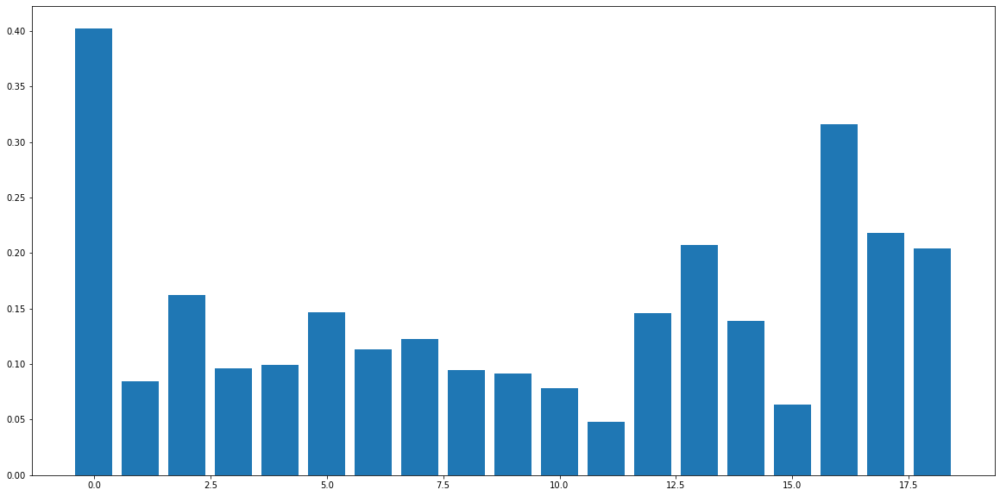

In [39]:
class_means = AVG_LOGITS.mean(dim=0).numpy()
labels = range(19)
plt.bar(labels, class_means)
plt.show()

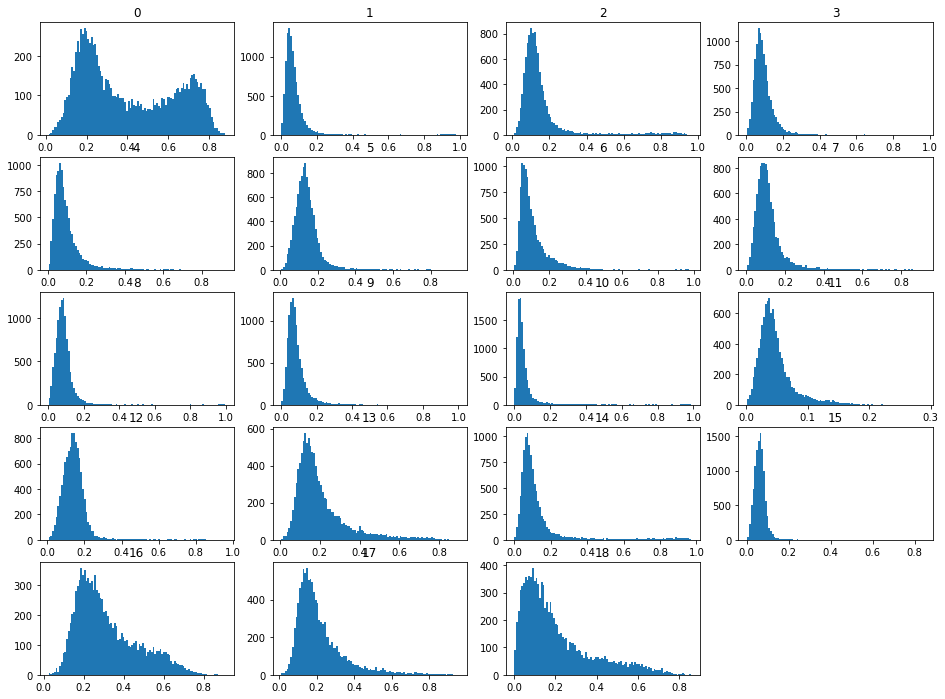

In [40]:
fig = plt.figure(figsize=(16, 12))

for i in labels:
    ax = fig.add_subplot(5,4,i+1)
    ax.hist(AVG_LOGITS[:,i].numpy(), bins=100)
    ax.set_title(i)

plt.show()

In [41]:
top_preds = AVG_LOGITS.argmax(dim=0).tolist()
top_kpreds = (-AVG_LOGITS).argsort(dim=0)[:6]
top30preds = (-AVG_LOGITS).argsort(dim=0)[30:33]
last_preds = (-AVG_LOGITS).argsort(dim=0)[-3:]
othe_preds = torch.cat([top30preds, last_preds], dim=0)
top_kvals = [[AVG_LOGITS[top_kpreds[i,j],j] for i in range(6)] for j in range(19)]
othe_vals = [[AVG_LOGITS[othe_preds[i,j],j] for i in range(6)] for j in range(19)]

In [42]:
HPA_LABEL_NAMES = {
    0: 'Nucleoplasm',
    1: 'Nuclear membrane',
    2: 'Nucleoli',
    3: 'Nucleoli fibrillar center',
    4: 'Nuclear speckles',
    5: 'Nuclear bodies',
    6: 'Endoplasmic reticulum',
    7: 'Golgi apparatus',
    8: 'Intermediate filaments',
    9: 'Actin filaments',
    10: 'Microtubules',
    11: 'Mitotic spindle',
    12: 'Centrosome',
    13: 'Plasma membrane',
    14: 'Mitochondria',
    15: 'Aggresome',
    16: 'Cytosol',
    17: 'Vesicles and punctate cytosolic patterns',
    18: 'Negative'
}

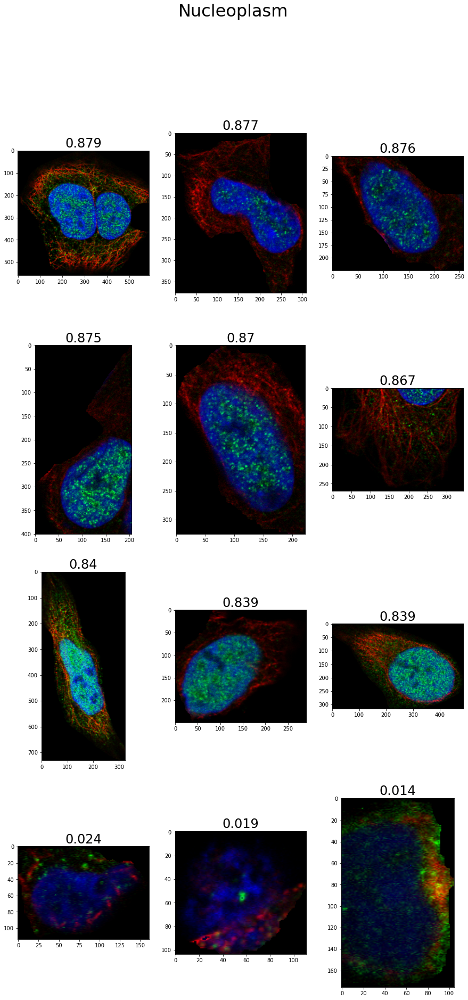

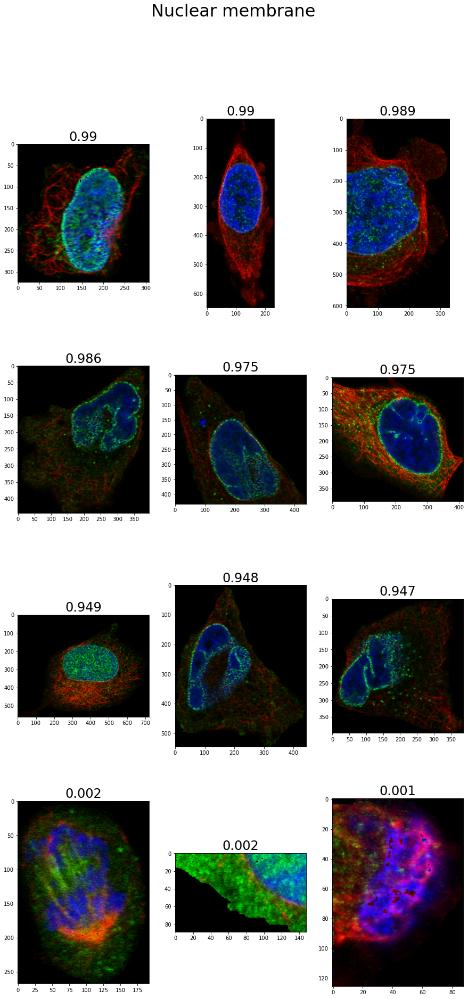

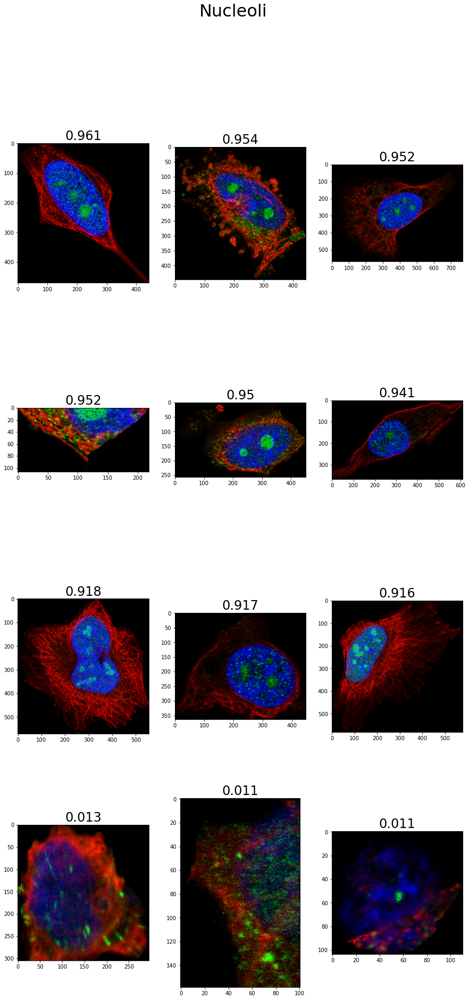

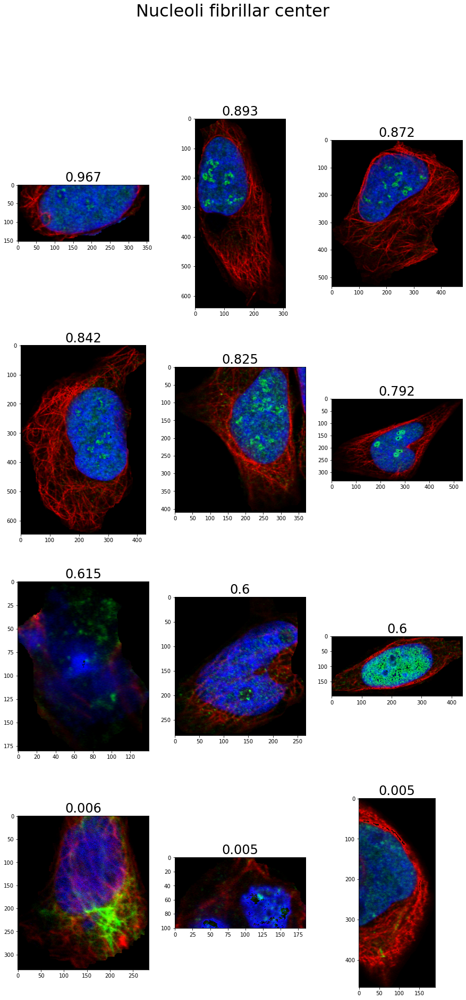

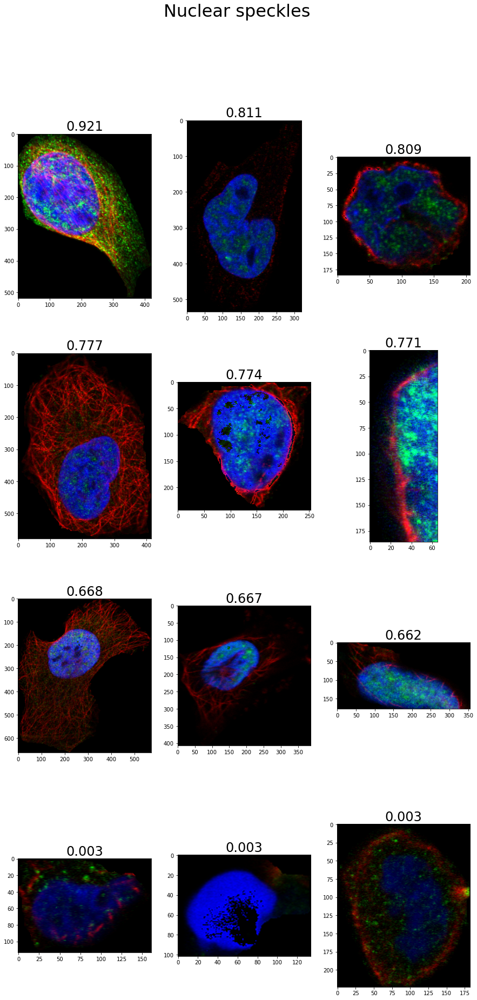

...

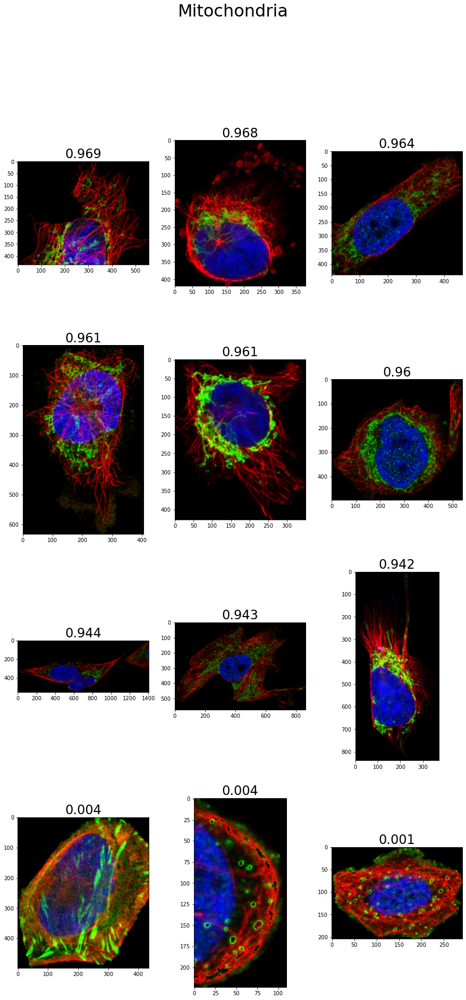

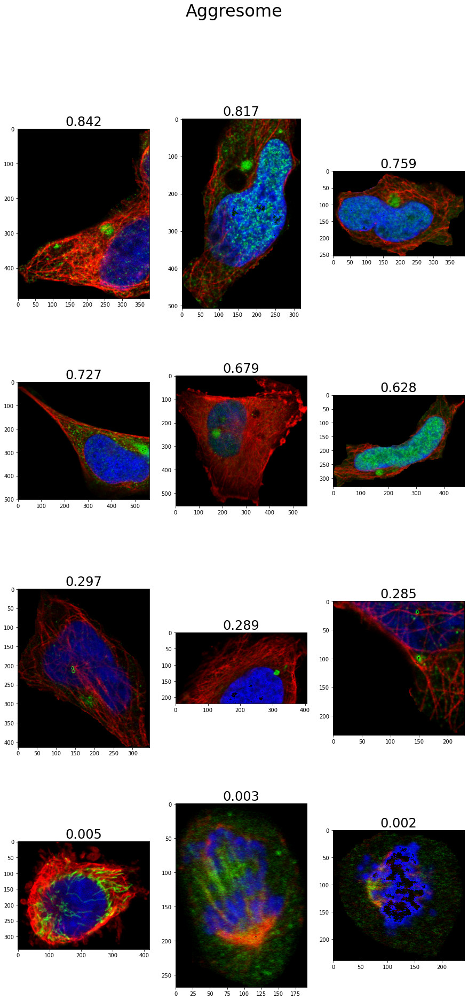

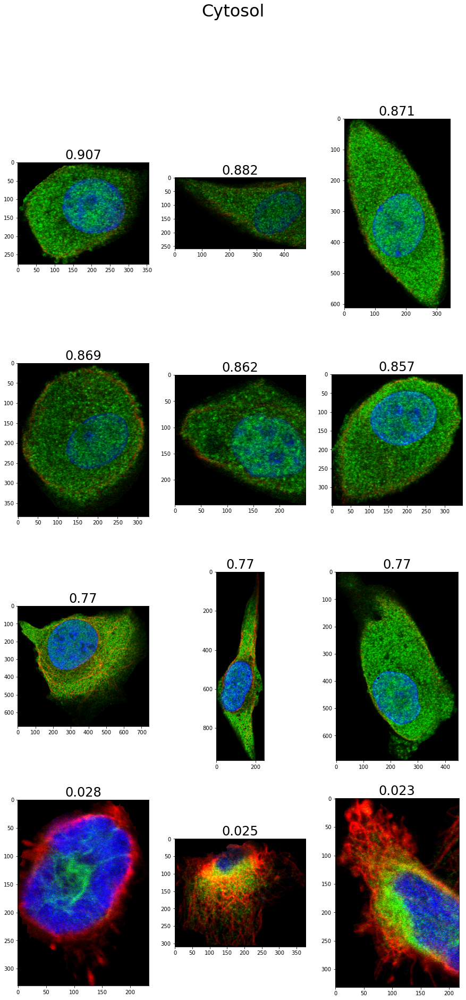

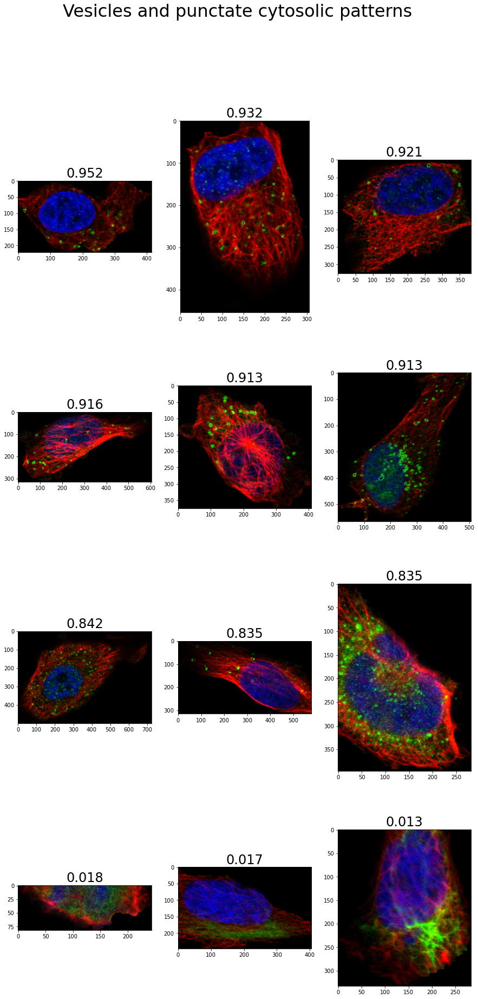

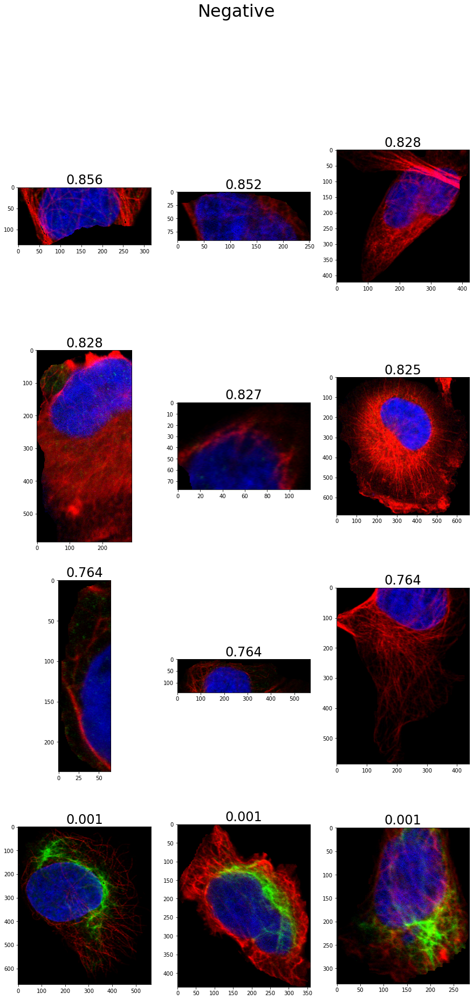

In [43]:
dataset_show = HPATestDataset(test_df, transform=None)
from pylab import rcParams
rcParams['figure.figsize'] = 15,30
rcParams['figure.titlesize'] = 32
rcParams['axes.titlesize'] = 24
rcParams['axes.labelsize'] = 20

for i in range(19):
    f, axarr = plt.subplots(4,3)
    f.suptitle(f'{HPA_LABEL_NAMES[i]}')
    for p in range(3):
        idx = top_kpreds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[0,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[0,p].title.set_text(f'{np.round(top_kvals[i][p].item(), 3)}')
    for p in range(3):
        idx = top_kpreds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[1,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[1,p].title.set_text(f'{np.round(top_kvals[i][p+3].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[2,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[2,p].title.set_text(f'{np.round(othe_vals[i][p].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[3,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[3,p].title.set_text(f'{np.round(othe_vals[i][p+3].item(), 3)}')